In [ ]:
!nvidia-smi

Wed Oct 29 18:05:22 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   56C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

##Importing dataset

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="9gdyMvguLnfQZZAsptyI")
project = rf.workspace("rjprojects").project("vehicle-detection-2rp6u-uijok")
version = project.version(1)
dataset = version.download("yolov11")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 90.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 132.9 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Vehicle-Detection--1 in yolov11:: 100%|██████████| 2224/2224 [00:05<00:00, 371.44it/s]


##Assigning training and validation

In [ ]:
dataset_dir = '/content/Vehicle-Detection--1'
train_yaml = f'{dataset_dir}/data.yaml'

In [ ]:
import os

print("Files in dataset_dir:", os.listdir(dataset_dir))

Files in dataset_dir: ['data.yaml', 'valid', 'train', 'README.roboflow.txt', 'README.dataset.txt', 'test']


##Model training

In [ ]:
!yolo detect train data=/content/Vehicle-Detection--1/data.yaml model=yolo11s.pt epochs=60 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.222 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Vehicle-Detection--1/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=60, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0

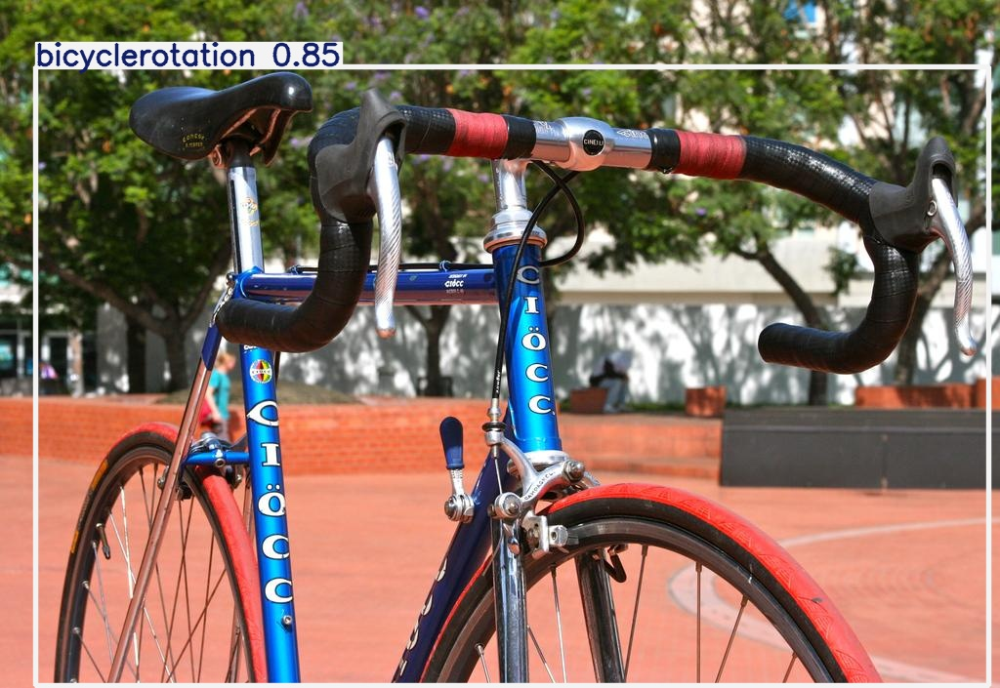

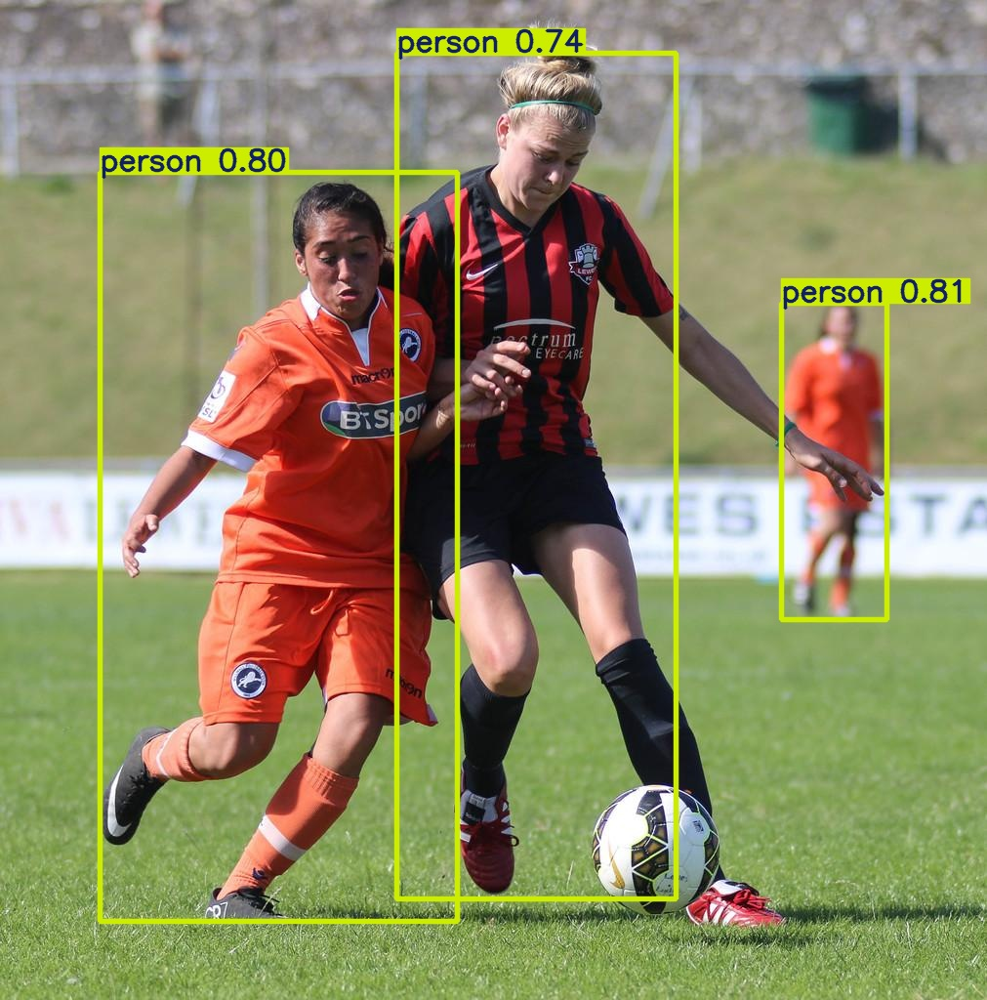

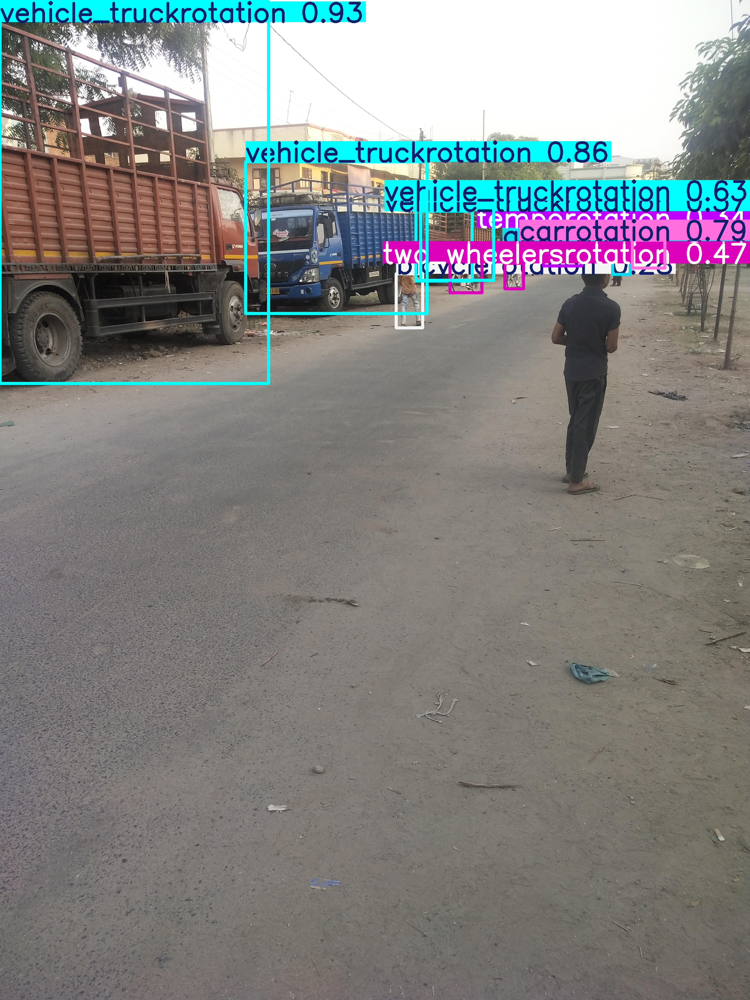

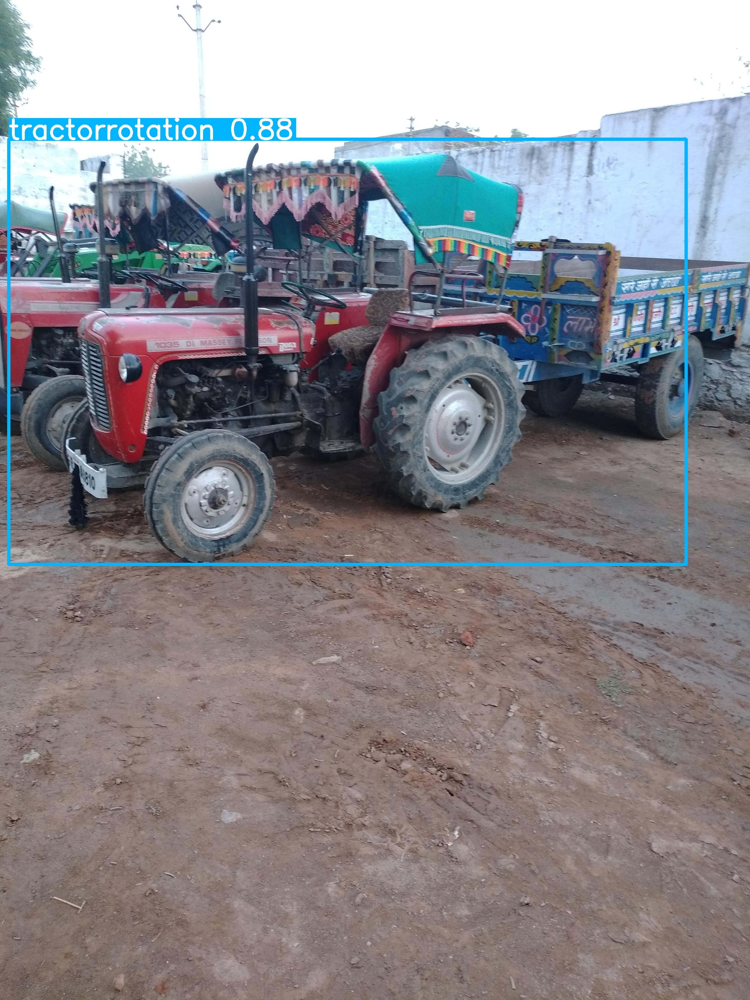

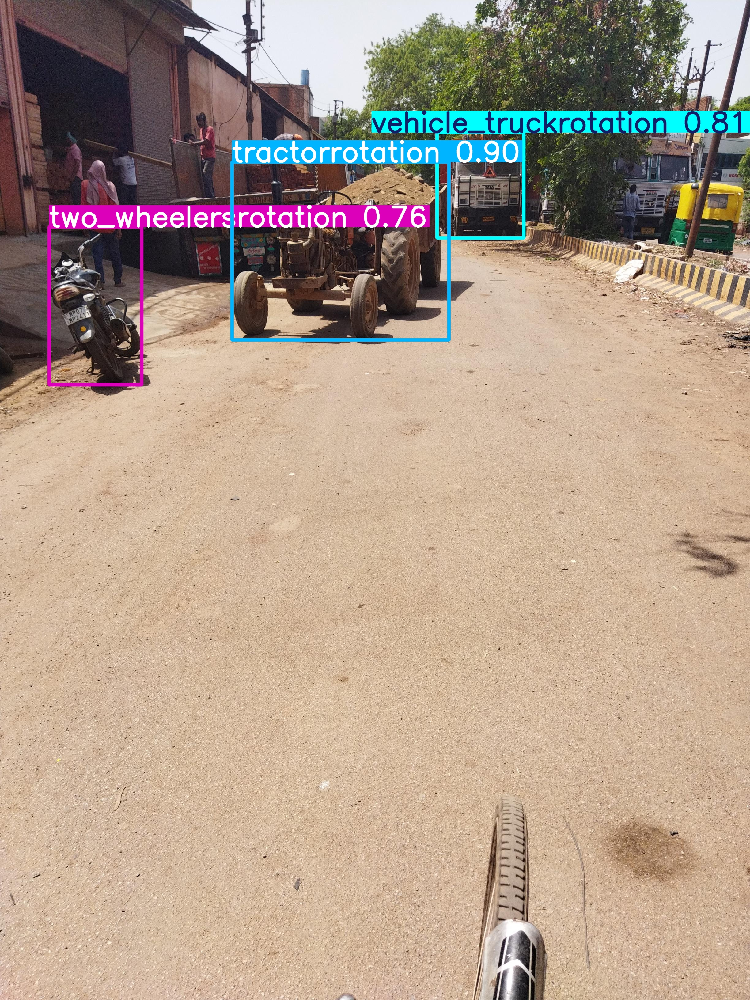

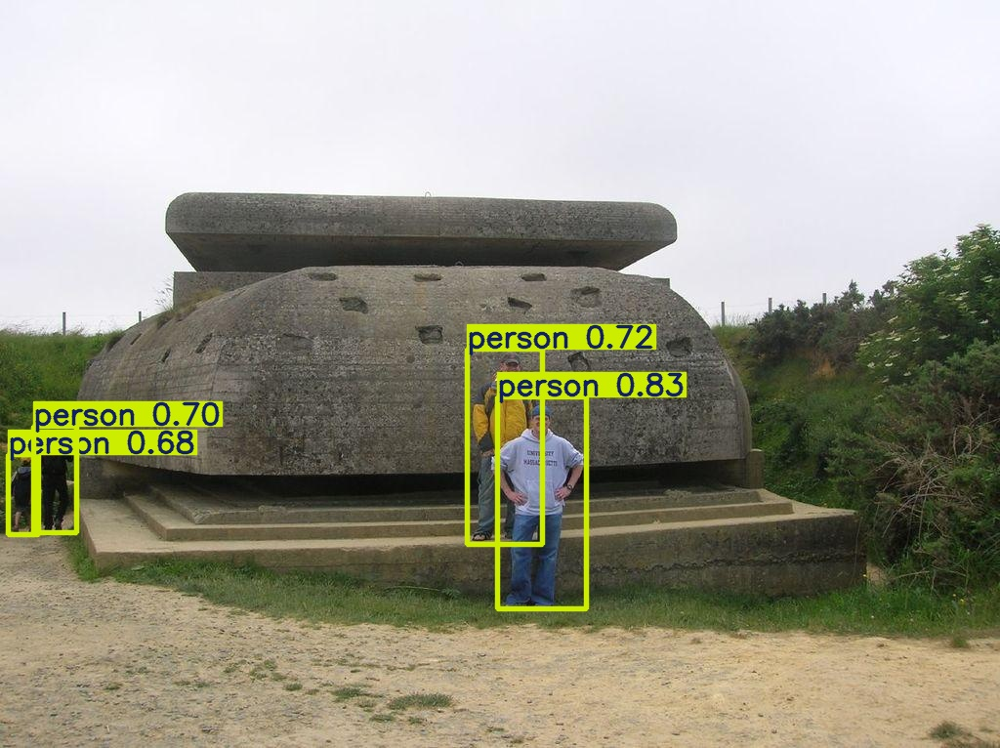

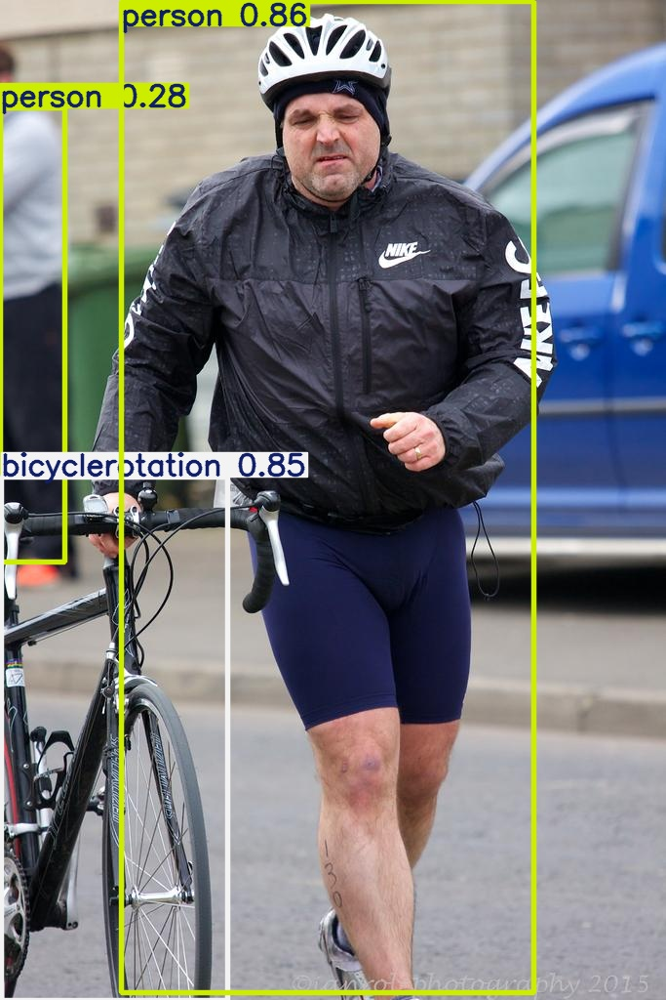

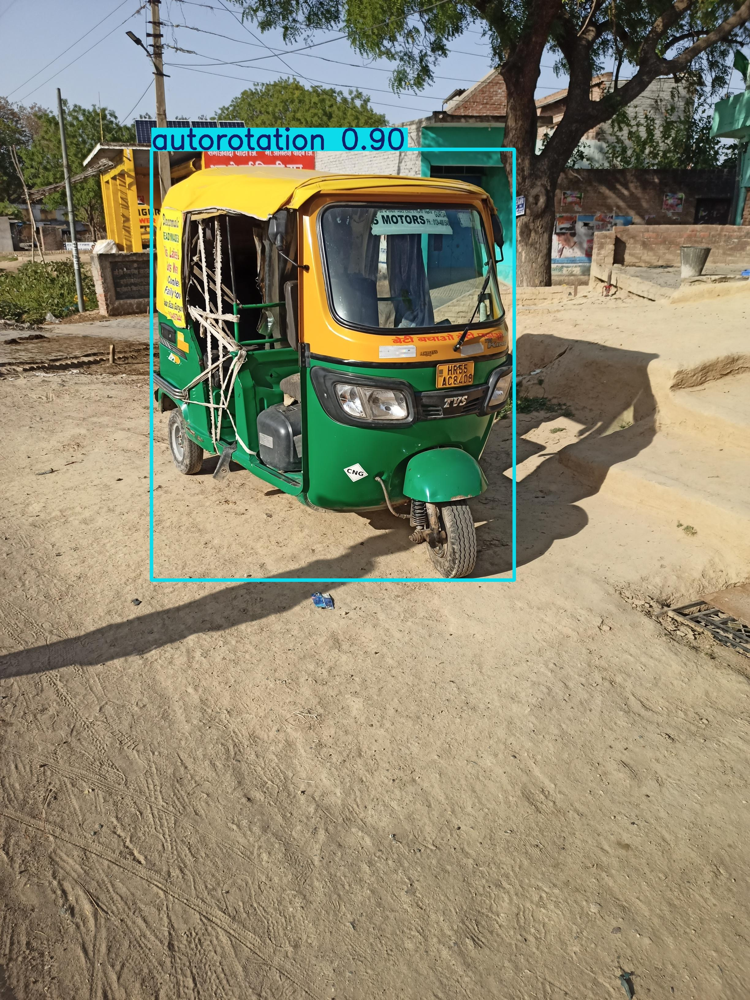

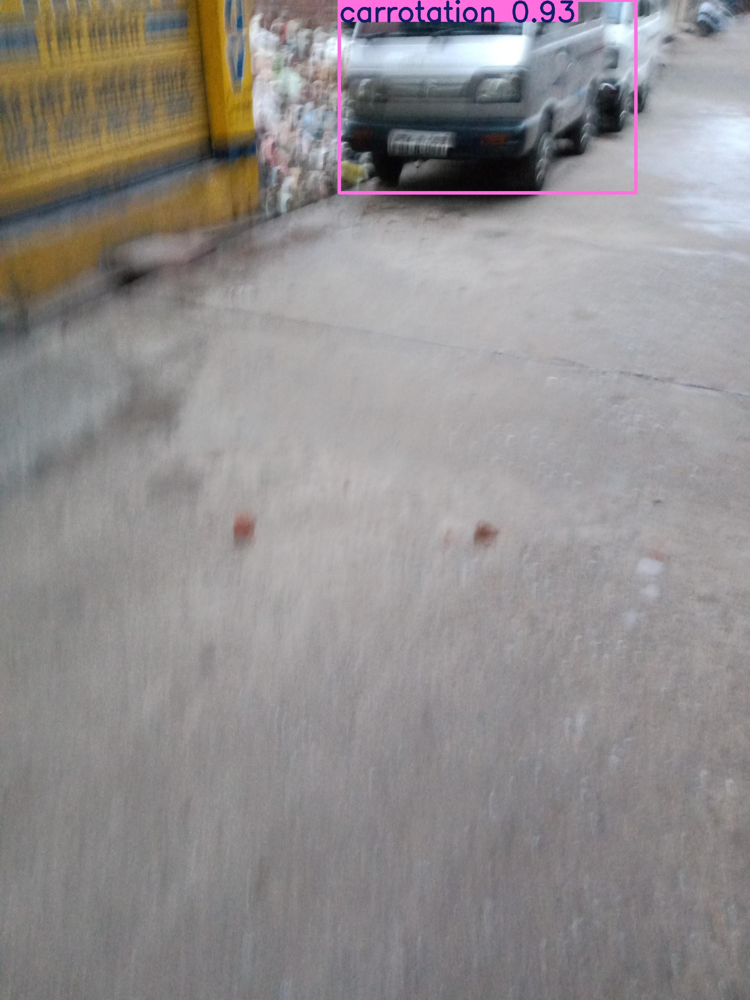

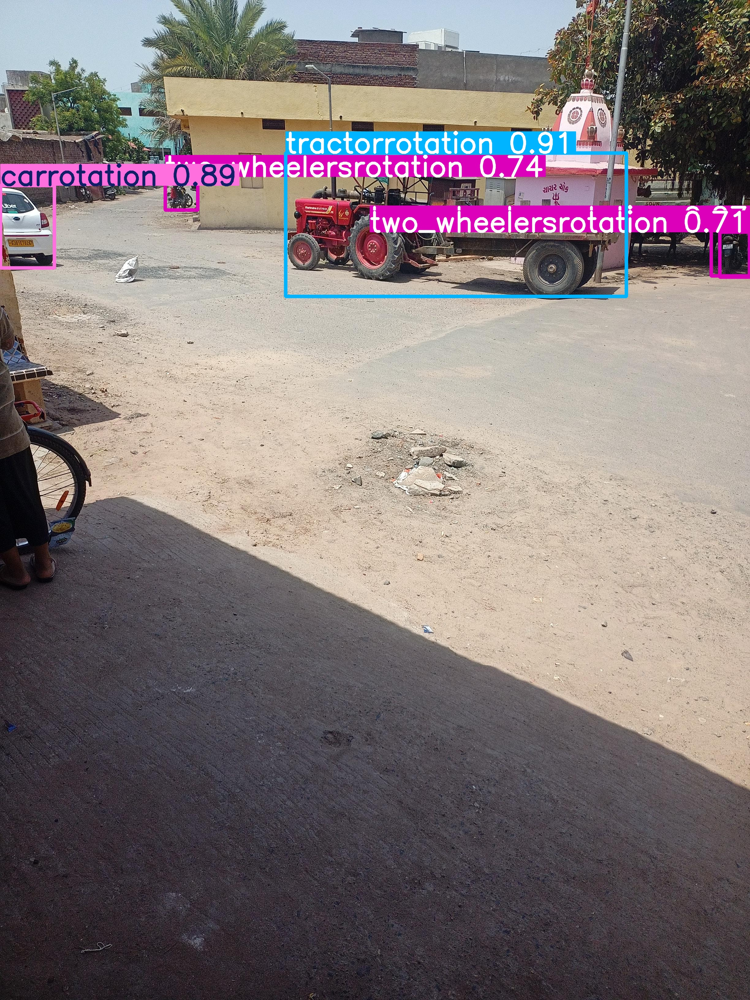

In [ ]:
import glob
from IPython.display import Image, display

# Adjust path if your predictions are saved to a custom folder
prediction_folder = '/content/runs/detect/predict'

for image_path in glob.glob(f'{prediction_folder}/*.jpg')[:10]:
    display(Image(filename=image_path, height=400))
    print('\n')


In [ ]:
from ultralytics import YOLO
m = YOLO('/content/runs/detect/train/weights/best.pt')
print(m.model.names)


{0: 'ambulance', 1: 'autorotation', 2: 'bicyclerotation', 3: 'bike', 4: 'busrotation', 5: 'carrotation', 6: 'fire_truck', 7: 'person', 8: 'police_vehicle', 9: 'temporotation', 10: 'tractorrotation', 11: 'two_wheelersrotation', 12: 'vehicle_truckrotation'}


In [ ]:
rename = {
  'autorotation':'autorickshaw',
  'bicyclerotation':'bicycle',
  'busrotation':'bus',
  'carrotation':'car',
  'fire_truck':'fire truck',
  'police_vehicle':'police vehicle',
  'temporotation':'tempo',
  'tractorrotation':'tractor',
  'two_wheelersrotation':'two wheeler',
  'vehicle_truckrotation':'truck'
}

from ultralytics import YOLO
m = YOLO('/content/runs/detect/train/weights/best.pt')
m.model.names = {i: rename.get(n, n) for i, n in m.model.names.items()}
m.save('/content/runs/detect/train/weights/best_renamed.pt')

In [ ]:
from ultralytics import YOLO
m = YOLO('/content/runs/detect/train/weights/best_renamed.pt')
print(m.model.names)

{0: 'ambulance', 1: 'autorickshaw', 2: 'bicycle', 3: 'bike', 4: 'bus', 5: 'car', 6: 'fire truck', 7: 'person', 8: 'police vehicle', 9: 'tempo', 10: 'tractor', 11: 'two wheeler', 12: 'truck'}


In [ ]:
from google.colab import files
files.download('/content/my_model.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>